<h1>HW5 - Generative Adversarial Networks (GANs)</h1>
<h3><font color=yellow>Total Points: 100</font></h3>



<font color=greeen>Please, name this file as HW5_Q7_{Student_ID}.ipynb</font>

<h2>Full Name: Javad Razi</h2>
<h2>Student ID: 401204354</h2>

# Init

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable
from torchvision import datasets, transforms

In [ ]:
# Data Preprocessing
transform = transforms.Compose([
    transforms.Resize(64),
    transforms.ToTensor()
])

# DataLoader
mnist_dataset = datasets.MNIST(root='./MNIST', train=True, transform=transform, download=True);
data_loader = torch.utils.data.DataLoader(dataset=mnist_dataset, batch_size=32, shuffle=True, num_workers=2);

100%|██████████| 9912422/9912422 [00:00<00:00, 87435407.73it/s]


Extracting ./MNIST/MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/MNIST/raw



100%|██████████| 28881/28881 [00:00<00:00, 94415973.36it/s]

Extracting ./MNIST/MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/MNIST/raw




100%|██████████| 1648877/1648877 [00:00<00:00, 33039802.20it/s]


Extracting ./MNIST/MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/MNIST/raw



100%|██████████| 4542/4542 [00:00<00:00, 18880603.34it/s]


Extracting ./MNIST/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/MNIST/raw



# Part 1: Implementation of a Basic GAN

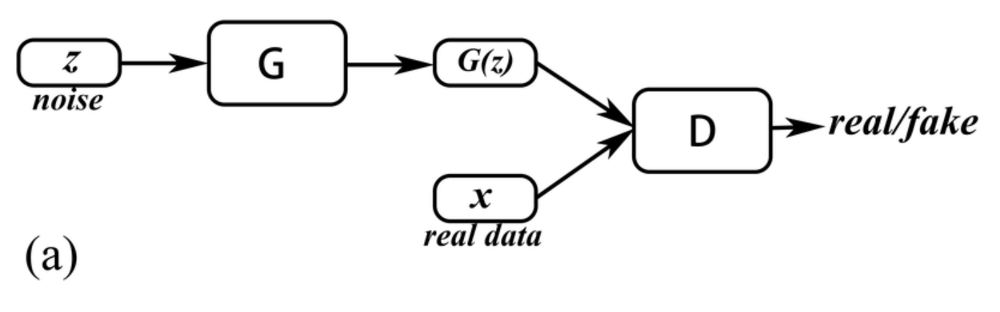

In this section, we will implement a basic Generative Adversarial Network (GAN) to generate fake images of handwritten digits using the MNIST dataset. The main components of this GAN include:

1. **Data Preprocessing**: Loading the MNIST dataset and applying necessary transformations.
2. **Generator**: A neural network that takes random noise as input and generates an image.
3. **Discriminator**: A neural network that takes an image as input and classifies it as real or fake.
4. **Training Loop**: Training the generator and discriminator in alternating steps.
5. **Results**: Visualizing the generated images and logging the training process.

Your task is to follow along with the provided code, understand the underlying concepts, and fill in any missing parts as instructed. Pay close attention to the network architectures, loss functions, and training dynamics to grasp how GANs function.


In [ ]:
class Generator(nn.Module):
    def __init__(self, z_dim=100):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(z_dim, 512, 4, 1, 0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),

            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.ConvTranspose2d(64, 1, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, z):
        z = z.view(z.size(0), z.size(1), 1, 1)
        return self.main(z)


In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(1, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(256, 512, 4, 2, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(512, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, image):
        return self.main(image).view(-1, 1)


In [ ]:
def save_fake_images(epoch, generator, fixed_z, batch_size, z_dim):
    sample_path = 'gan'
    if not os.path.exists(sample_path):
        os.makedirs(sample_path)

    fake_images = generator(fixed_z).view(batch_size, 1, 64, 64)
    plt.figure(figsize=(16, 4))
    for i in range(8):
        img = fake_images[i].cpu().detach().squeeze().numpy()
        img = (img + 1) / 2
        img = np.clip(img, 0, 1)

        plt.subplot(1, 8, i+1)
        plt.imshow(img, cmap='gray')
        plt.axis('off')

    plt.show()

In [ ]:
def train_discriminator(discriminator, images, real_labels, fake_images, fake_labels, criterion, optimizer):
    optimizer.zero_grad()

    # Train with real images
    real_output = discriminator(images)
    d_loss_real = criterion(real_output, real_labels)
    d_loss_real.backward()

    # Train with fake images
    fake_output = discriminator(fake_images)
    d_loss_fake = criterion(fake_output, fake_labels)
    d_loss_fake.backward()

    # Update discriminator weights
    optimizer.step()

    return d_loss_real.item() + d_loss_fake.item()

def train_generator(discriminator, fake_images, real_labels, criterion, optimizer):
    optimizer.zero_grad()

    # Training to produce images that are classified as real
    prob_fake = discriminator(fake_images)
    g_loss = criterion(prob_fake, real_labels)

    # Backpropagation and optimization
    g_loss.backward()
    optimizer.step()

    return g_loss.item()


Epoch 1, Step 1871, D Loss: 0.0273, G Loss: 5.4857

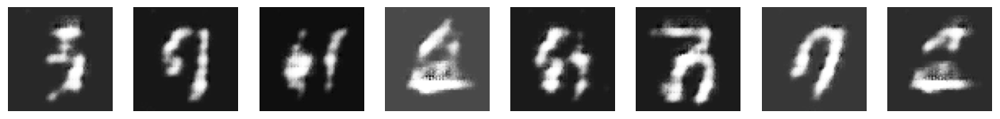

Epoch 2, Step 1871, D Loss: 0.1211, G Loss: 7.1051

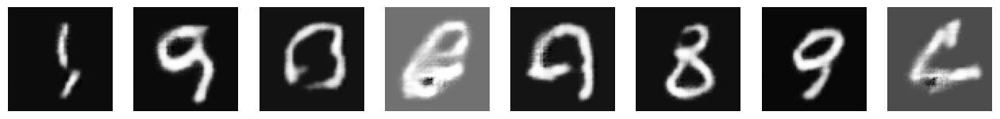

Epoch 3, Step 1871, D Loss: 0.3287, G Loss: 3.8365

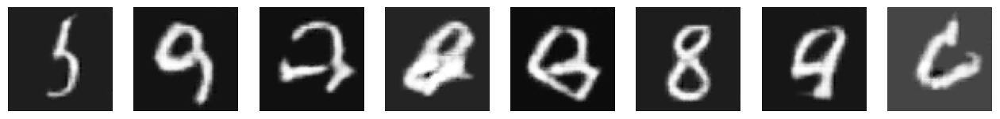

Epoch 4, Step 1871, D Loss: 0.0326, G Loss: 4.9384

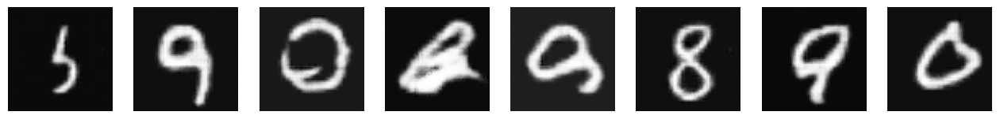

Epoch 5, Step 1871, D Loss: 0.1799, G Loss: 6.9634

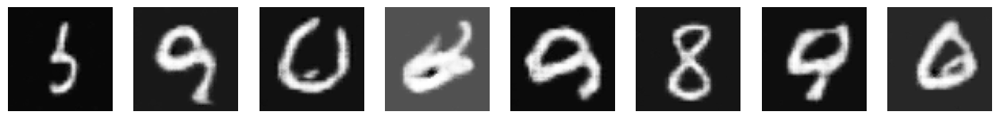

Epoch 6, Step 1871, D Loss: 0.0045, G Loss: 4.4141

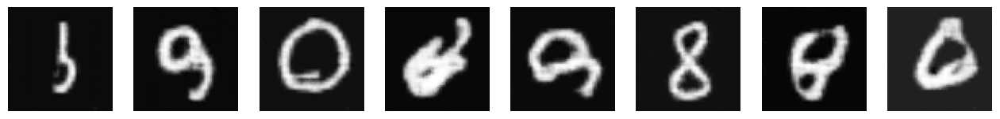

Epoch 7, Step 1871, D Loss: 0.0096, G Loss: 4.6192

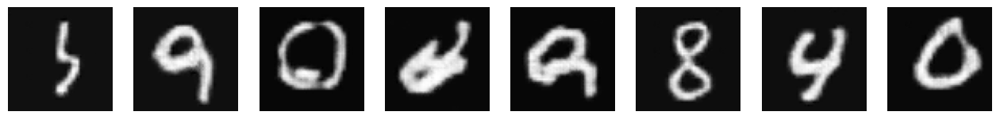

Epoch 8, Step 1871, D Loss: 0.0065, G Loss: 8.4913

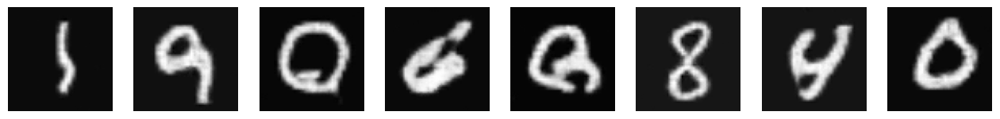

Epoch 9, Step 1871, D Loss: 0.0987, G Loss: 6.8232

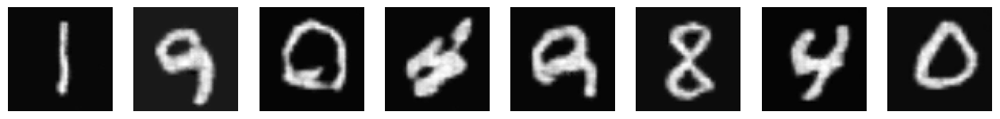

Epoch 10, Step 1871, D Loss: 0.0046, G Loss: 4.7247

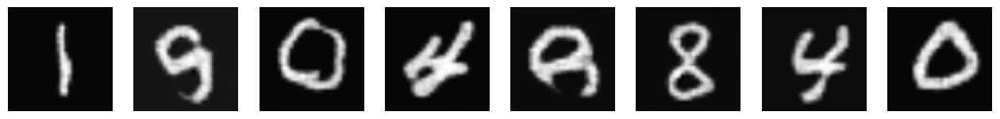

Epoch 11, Step 1871, D Loss: 0.0010, G Loss: 7.5961

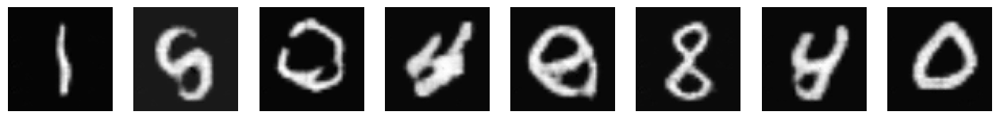

Epoch 12, Step 1871, D Loss: 0.1674, G Loss: 8.7068

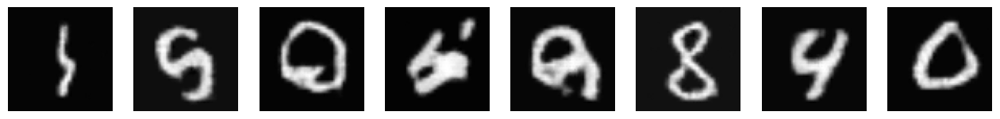

Epoch 13, Step 1871, D Loss: 0.0010, G Loss: 11.7716

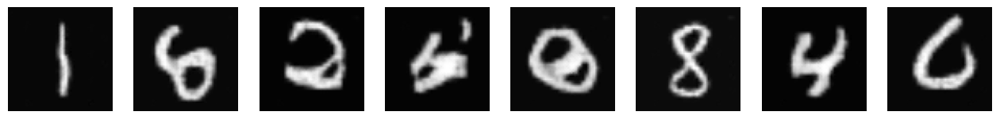

Epoch 14, Step 1871, D Loss: 0.0032, G Loss: 7.6310

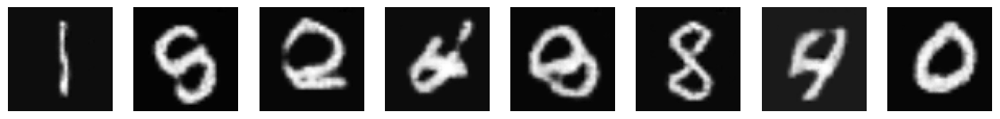

Epoch 15, Step 1871, D Loss: 0.0007, G Loss: 9.3413

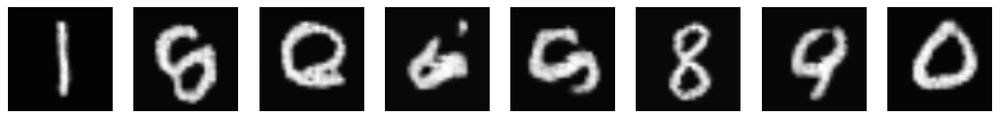

Epoch 16, Step 1871, D Loss: 0.0078, G Loss: 7.7296

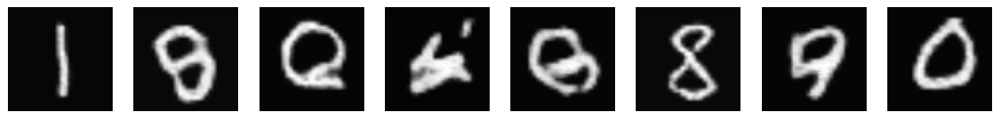

Epoch 17, Step 1871, D Loss: 0.0207, G Loss: 4.5462

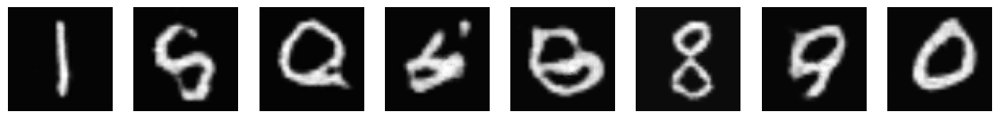

Epoch 18, Step 1871, D Loss: 0.0012, G Loss: 6.6731

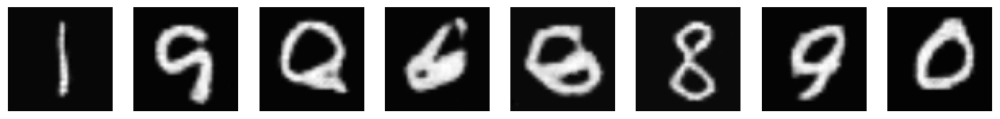

Epoch 19, Step 1871, D Loss: 0.0066, G Loss: 6.8190

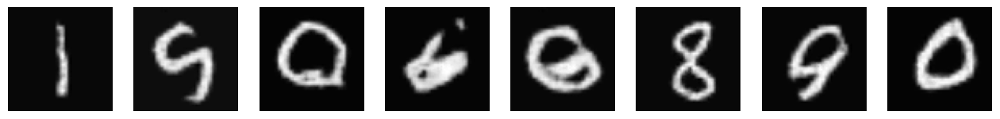

Epoch 20, Step 1871, D Loss: 0.0006, G Loss: 7.8692

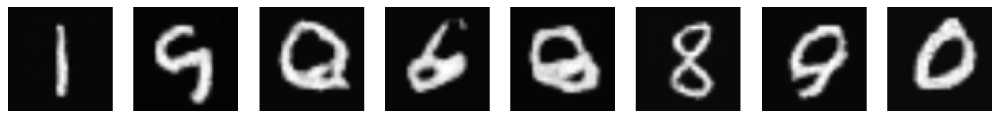

In [ ]:
num_epochs = 20
batch_size = 32
z_dim = 100
criterion = nn.BCELoss()

generator = Generator().cuda()
discriminator = Discriminator().cuda()

# Define optimizer
d_optimizer = torch.optim.Adam(discriminator.parameters(),lr=0.0002)
g_optimizer = torch.optim.Adam(generator.parameters(),lr=0.0002)

# To generate a few images after each epoch
fixed_z = Variable(torch.randn(batch_size, z_dim)).cuda()

for epoch in range(num_epochs):
    for i, (images, _) in enumerate(data_loader):
        images = images.cuda()
        z = Variable(torch.randn(batch_size, z_dim)).cuda()
        real_labels = torch.ones(batch_size, 1).cuda()
        fake_labels = torch.zeros(batch_size, 1).cuda()

        # Train Discriminator
        fake_image = generator(z)
        d_loss = train_discriminator(discriminator, images, real_labels, fake_image, fake_labels, criterion, d_optimizer)

        # Train Generator
        z = Variable(torch.randn(batch_size, z_dim)).cuda()
        fake_image = generator(z)
        g_loss = train_generator(discriminator, fake_image, real_labels, criterion, g_optimizer)

        if i % 10 == 0:
            print(f'\rEpoch {epoch+1}, Step {i+1}, D Loss: {d_loss:.4f}, G Loss: {g_loss:.4f}',end='')

    # Generate and save a few fake images
    save_fake_images(epoch+1, generator, fixed_z, batch_size, z_dim)

<br><br><br><br><br><br><br><br>

# Part 2: Implementation of a Conditional GAN (CGAN)

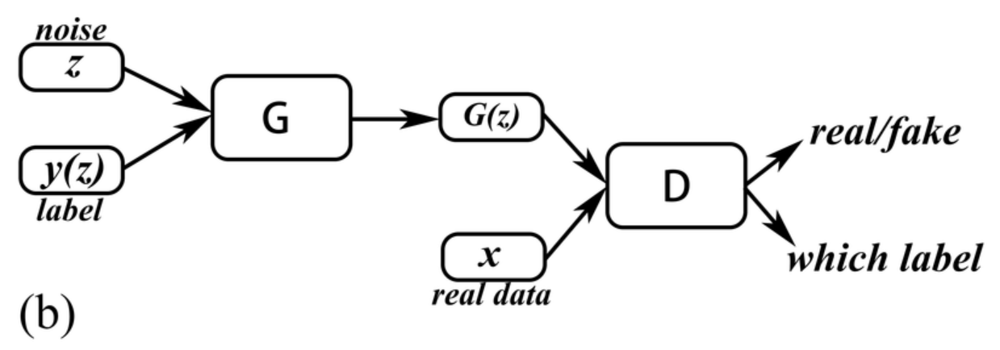

In this section, we will implement a Conditional Generative Adversarial Network (CGAN) to generate fake images of handwritten digits, conditioned on their labels, using the MNIST dataset. This means that we can generate images of specific digits by providing the desired digit label as input to the generator.

The main components of this CGAN include:

1. **Data Preprocessing**: Loading the MNIST dataset with labels and applying necessary transformations.
2. **Generator**: A neural network that takes random noise and a digit label as input and generates an image.
3. **Discriminator**: A neural network that takes an image and a digit label as input and classifies it as real or fake.
4. **Training Loop**: Training the generator and discriminator in alternating steps, taking the digit labels into account.
5. **Results**: Visualizing the generated images conditioned on labels and logging the training process.


In [79]:
class ConditionalGenerator(nn.Module):
    def __init__(self, z_dim=100, label_dim=10):
        super(ConditionalGenerator, self).__init__()
        self.label_embedding = nn.Embedding(label_dim, label_dim)
        self.model = nn.Sequential(
            nn.Linear(z_dim + label_dim, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Linear(128, 256),
            nn.BatchNorm1d(256),
            nn.ReLU(),
            nn.Linear(256, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Linear(512, 1024),
            nn.BatchNorm1d(1024),
            nn.ReLU(),
            nn.Linear(1024, 64 * 64),
            nn.Tanh()  # Output is a 64x64 image
        )

    def forward(self, noise, labels):
        labels = self.label_embedding(labels)
        labels = labels.view(labels.size(0), -1)
        gen_input = torch.cat((noise, labels), 1)  # Concatenate along the feature dimension
        img = self.model(gen_input)
        img = img.view(img.size(0), 1, 64, 64)
        return img

In [80]:
class ConditionalDiscriminator(nn.Module):
    def __init__(self, label_dim=10):
        super(ConditionalDiscriminator, self).__init__()
        self.label_embedding = nn.Embedding(label_dim, label_dim)
        self.model = nn.Sequential(
            nn.Linear(64 * 64 + label_dim, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.4),
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.4),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.4),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )

    def forward(self, img, labels):
        # Concatenate label embedding and image to produce input
        d_in = torch.cat((img.view(img.size(0), -1), self.label_embedding(labels)), -1)
        validity = self.model(d_in)
        return validity

In [81]:
# Initialize generator and discriminator
generator = ConditionalGenerator().cuda()
discriminator = ConditionalDiscriminator().cuda()

# Loss functions
adversarial_loss = torch.nn.BCELoss()

# Optimizers
optimizer_G = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

In [82]:
def save_fake_labled_images(epoch=0):
    sample_path = 'cgan/'
    if not os.path.exists(sample_path):
        os.makedirs(sample_path)

    sample_labels = torch.arange(10).type(torch.LongTensor).cuda()
    z = torch.randn(10, 100).cuda()
    gen_imgs = generator(z, sample_labels)

    fig, axs = plt.subplots(1, 10, figsize=(18, 2))

    for i in range(10):
        img = gen_imgs[i].cpu().detach().squeeze().numpy()
        img = (img + 1) / 2
        img = np.clip(img, 0, 1)

        axs[i].imshow(img, cmap='gray')
        axs[i].set_title(f"Label: {i}")
        axs[i].axis('off')

    plt.tight_layout()
    plt.savefig(sample_path + f"generated_images_with_labels_{epoch}.png")
    plt.show()

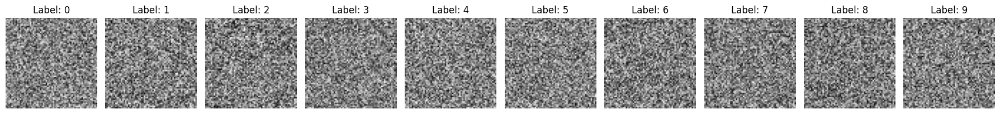

In [83]:
save_fake_labled_images(epoch=0)

Epoch 1, Step 1871, D Loss: 0.3703, G Loss: 1.6081

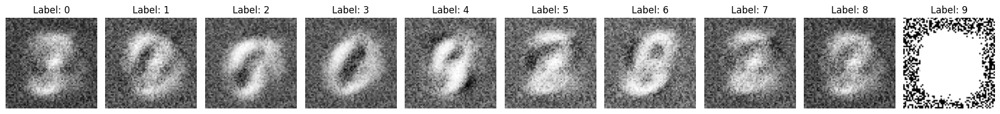

Epoch 2, Step 1871, D Loss: 0.3751, G Loss: 6.7256

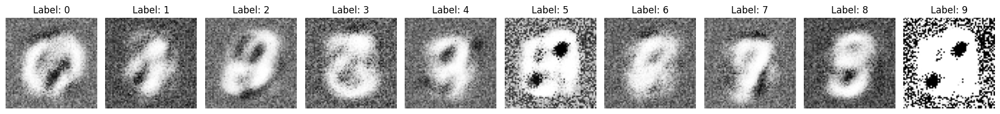

Epoch 3, Step 1871, D Loss: 0.1375, G Loss: 5.1257

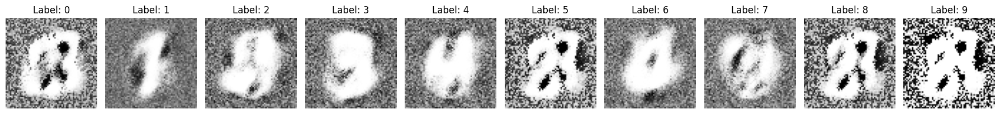

Epoch 4, Step 1871, D Loss: 0.2824, G Loss: 2.8190

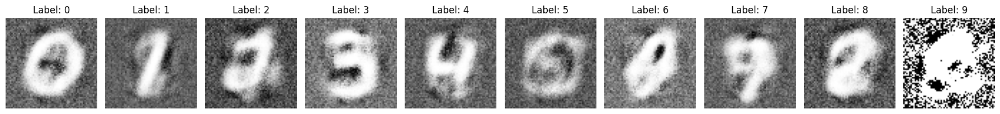

Epoch 5, Step 1871, D Loss: 0.3397, G Loss: 2.2740

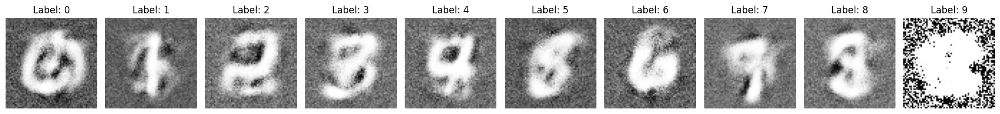

Epoch 6, Step 1871, D Loss: 0.2898, G Loss: 2.7161

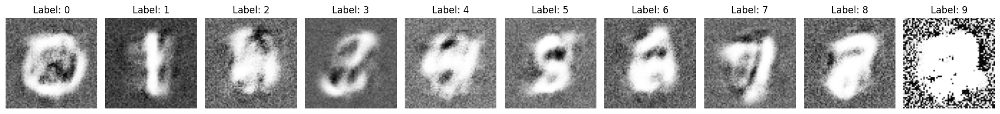

Epoch 7, Step 1871, D Loss: 0.3230, G Loss: 2.6294

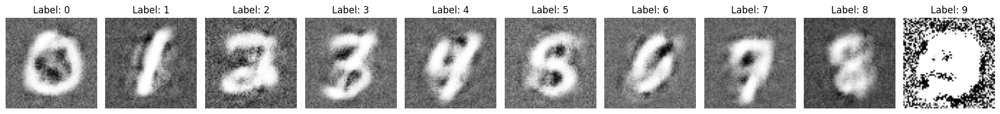

Epoch 8, Step 1871, D Loss: 0.3483, G Loss: 1.9226

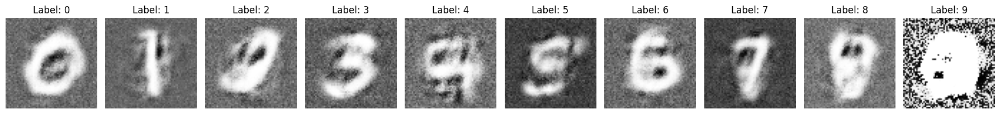

Epoch 9, Step 1871, D Loss: 0.4095, G Loss: 1.8848

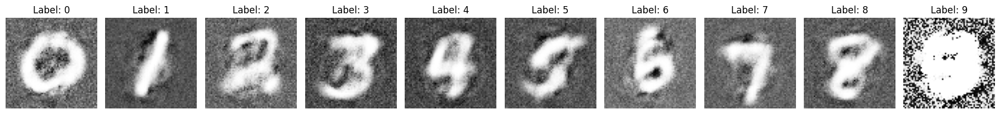

Epoch 10, Step 1871, D Loss: 0.3253, G Loss: 2.0707

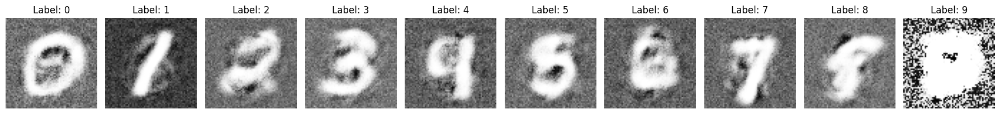

Epoch 11, Step 1871, D Loss: 0.2516, G Loss: 2.5918

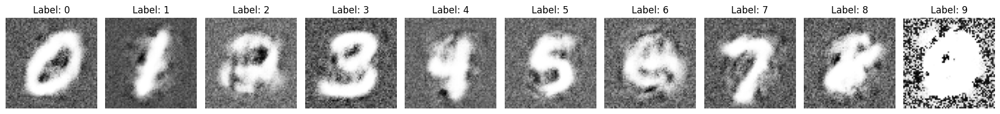

Epoch 12, Step 1871, D Loss: 0.5695, G Loss: 1.3739

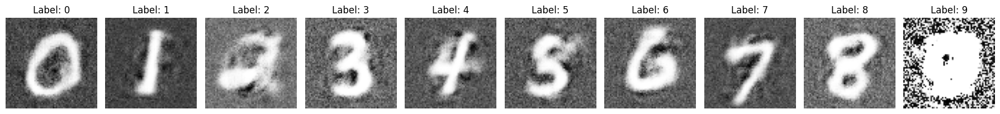

Epoch 13, Step 1871, D Loss: 0.3750, G Loss: 1.3579

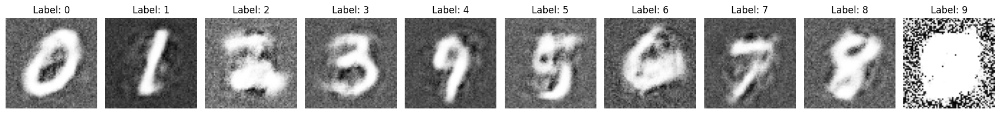

Epoch 14, Step 1871, D Loss: 0.3982, G Loss: 1.4872

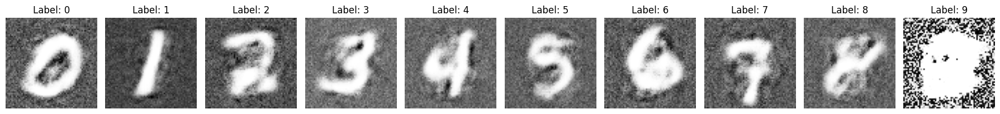

Epoch 15, Step 1871, D Loss: 0.3819, G Loss: 2.0577

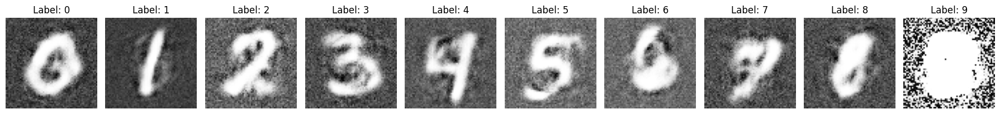

Epoch 16, Step 1871, D Loss: 0.4994, G Loss: 0.9094

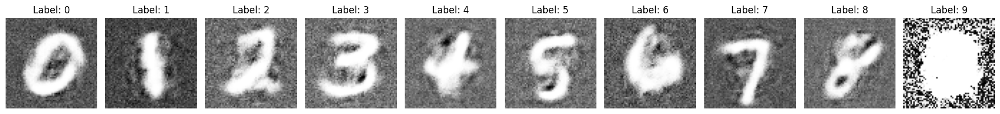

Epoch 17, Step 1871, D Loss: 0.5708, G Loss: 1.6130

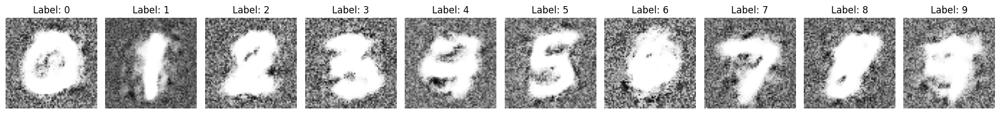

Epoch 18, Step 1871, D Loss: 0.3740, G Loss: 1.7984

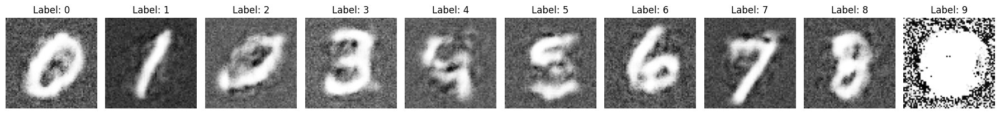

Epoch 19, Step 1871, D Loss: 0.3818, G Loss: 1.6666

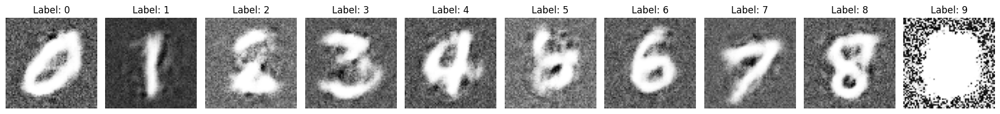

Epoch 20, Step 1871, D Loss: 0.4526, G Loss: 2.2988

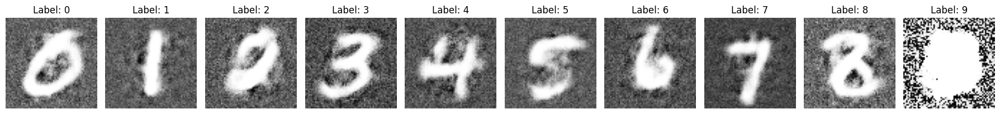

Epoch 21, Step 1871, D Loss: 0.5177, G Loss: 1.4251

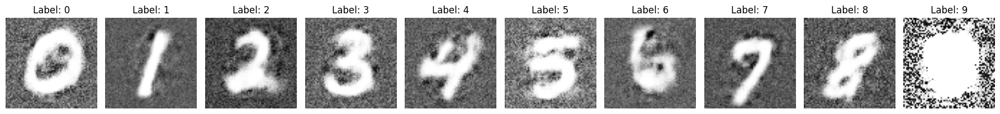

Epoch 22, Step 1871, D Loss: 0.4274, G Loss: 1.9963

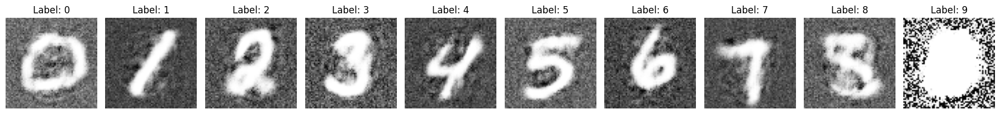

Epoch 23, Step 1871, D Loss: 0.3819, G Loss: 1.2349

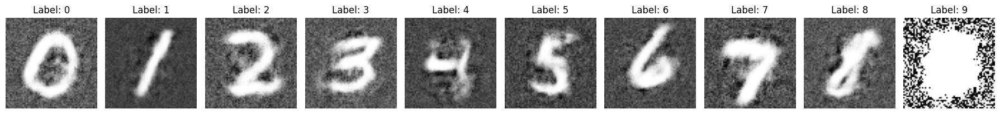

Epoch 24, Step 1871, D Loss: 0.4490, G Loss: 1.2461

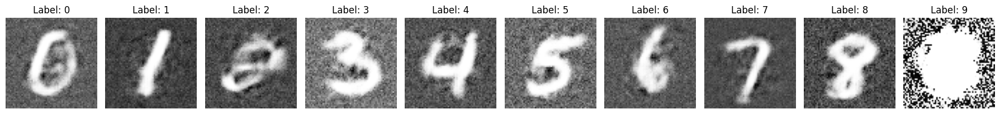

Epoch 25, Step 1871, D Loss: 0.4949, G Loss: 2.1837

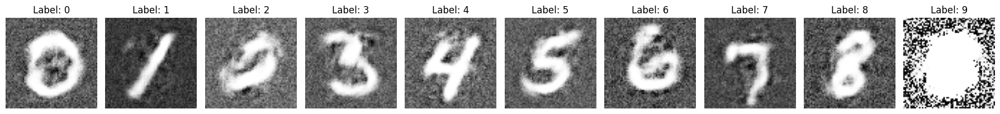

Epoch 26, Step 1871, D Loss: 0.3245, G Loss: 1.9468

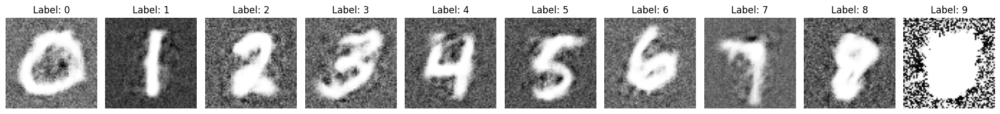

Epoch 27, Step 1871, D Loss: 0.5387, G Loss: 1.5647

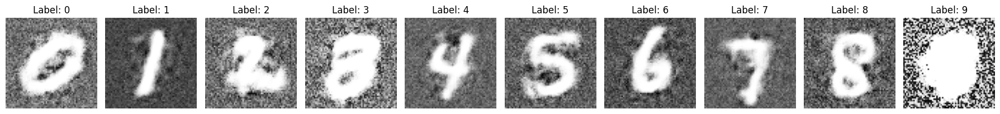

Epoch 28, Step 1871, D Loss: 0.5590, G Loss: 1.5066

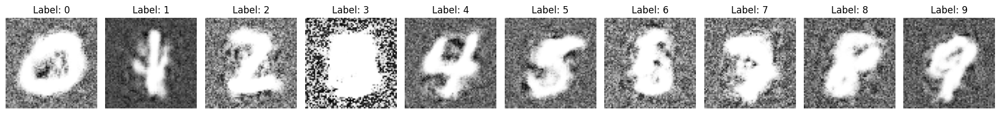

Epoch 29, Step 1871, D Loss: 0.5889, G Loss: 1.2250

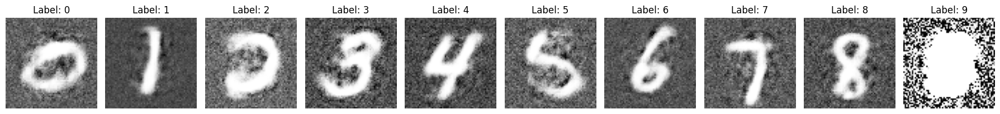

Epoch 30, Step 1871, D Loss: 0.4596, G Loss: 1.0181

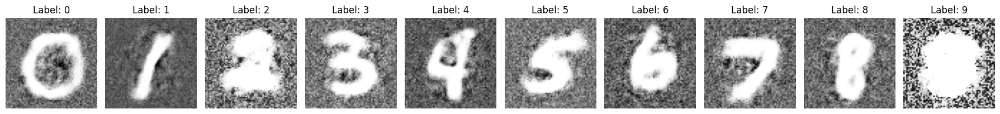

Epoch 31, Step 1871, D Loss: 0.5169, G Loss: 1.3824

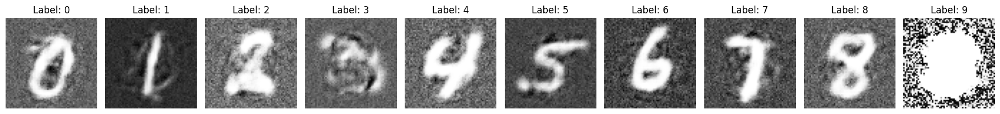

Epoch 32, Step 1871, D Loss: 0.5697, G Loss: 0.8409

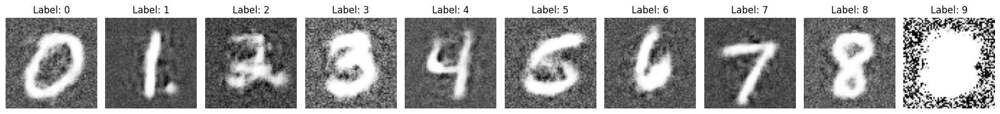

Epoch 33, Step 1871, D Loss: 0.4921, G Loss: 1.4976

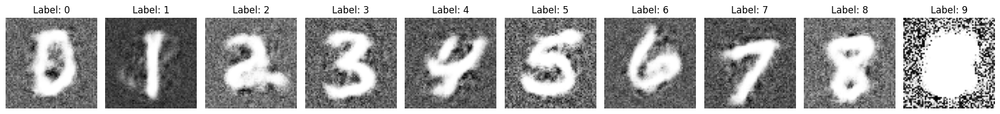

Epoch 34, Step 1871, D Loss: 0.5912, G Loss: 1.3348

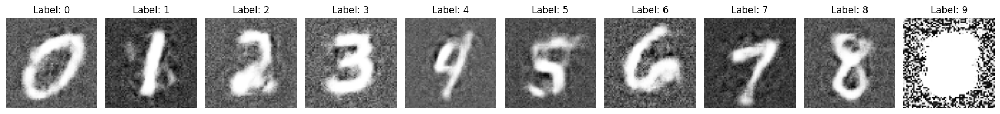

Epoch 35, Step 1871, D Loss: 0.5016, G Loss: 1.2517

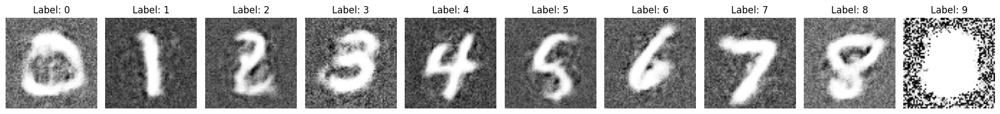

Epoch 36, Step 1871, D Loss: 0.5676, G Loss: 1.3622

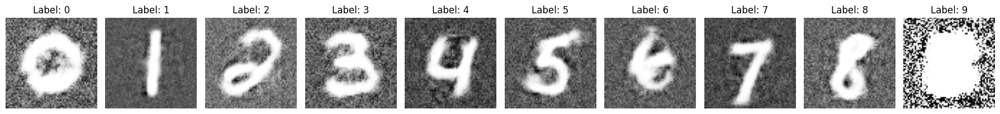

Epoch 37, Step 1871, D Loss: 0.5923, G Loss: 1.2258

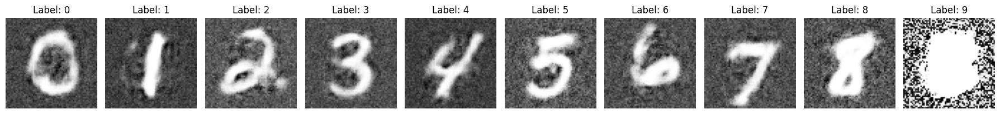

Epoch 38, Step 1871, D Loss: 0.5774, G Loss: 1.0767

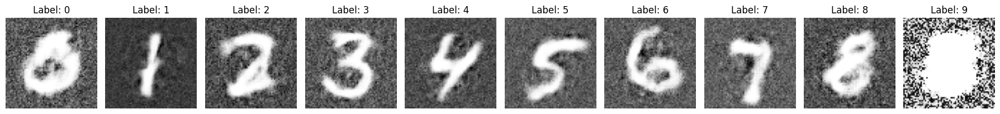

Epoch 39, Step 1871, D Loss: 0.6205, G Loss: 1.0394

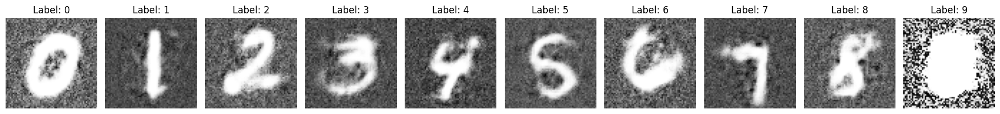

Epoch 40, Step 1871, D Loss: 0.6667, G Loss: 0.9560

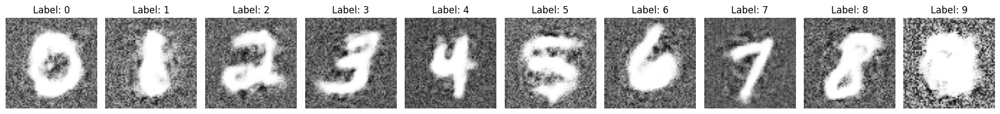

Epoch 41, Step 1871, D Loss: 0.6838, G Loss: 1.3353

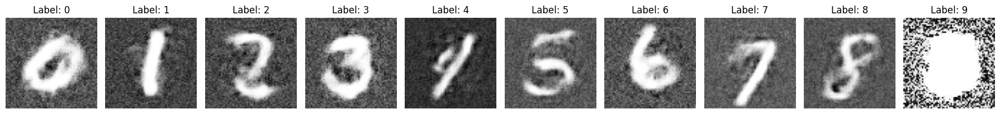

Epoch 42, Step 1871, D Loss: 0.5677, G Loss: 1.2849

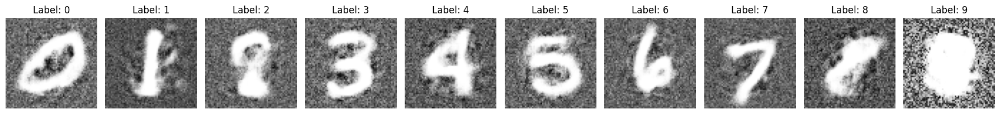

Epoch 43, Step 1871, D Loss: 0.4777, G Loss: 1.3940

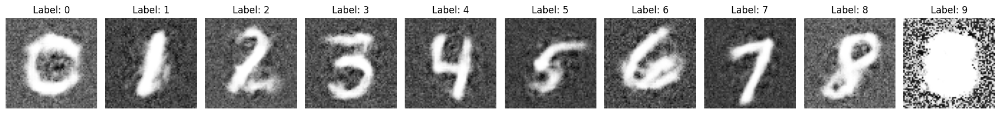

Epoch 44, Step 1871, D Loss: 0.5723, G Loss: 1.5075

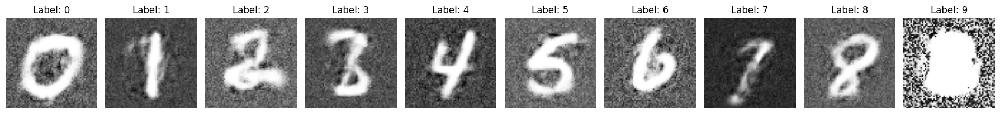

Epoch 45, Step 1871, D Loss: 0.5361, G Loss: 1.3140

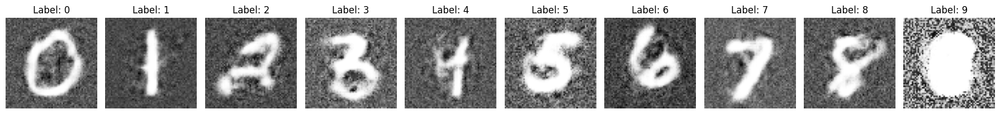

Epoch 46, Step 1871, D Loss: 0.4648, G Loss: 1.2093

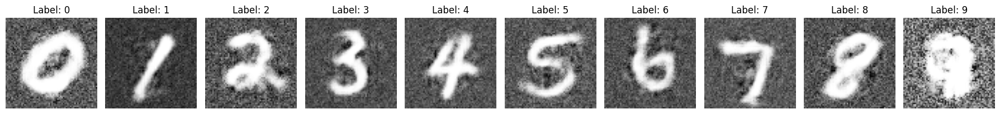

Epoch 47, Step 1871, D Loss: 0.6127, G Loss: 0.8493

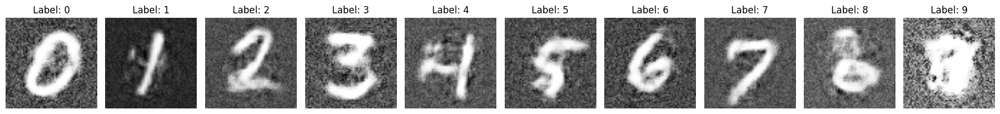

Epoch 48, Step 1871, D Loss: 0.5783, G Loss: 1.4294

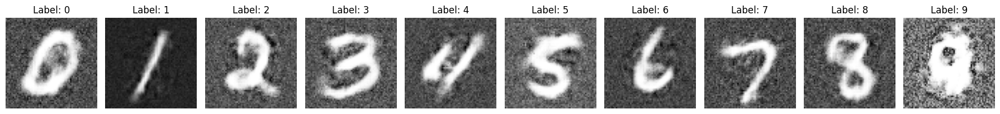

Epoch 49, Step 1871, D Loss: 0.5216, G Loss: 1.0994

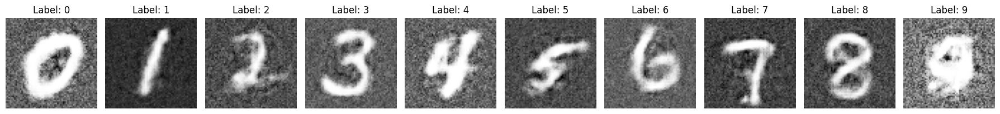

Epoch 50, Step 1871, D Loss: 0.4492, G Loss: 0.9272

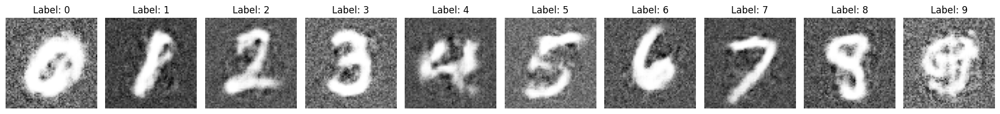

Epoch 51, Step 1871, D Loss: 0.5858, G Loss: 0.9075

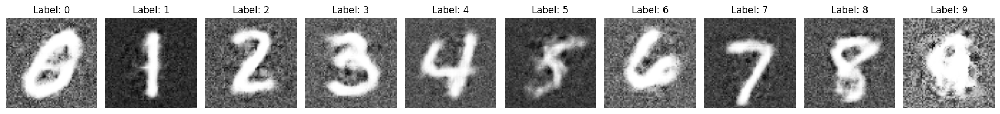

Epoch 52, Step 1871, D Loss: 0.5830, G Loss: 0.9927

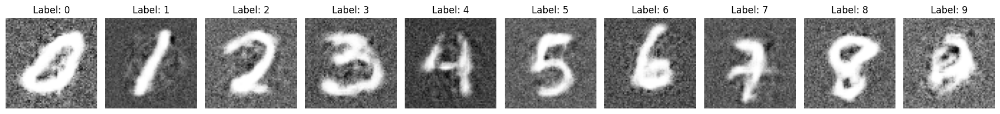

Epoch 53, Step 1871, D Loss: 0.5513, G Loss: 1.2572

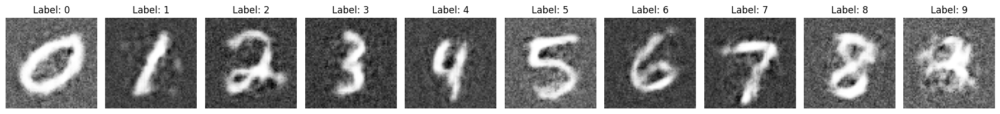

Epoch 54, Step 1871, D Loss: 0.5577, G Loss: 1.0285

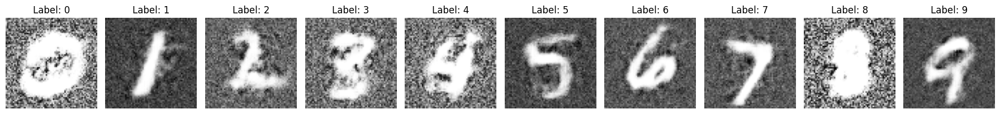

Epoch 55, Step 1871, D Loss: 0.6241, G Loss: 0.9881

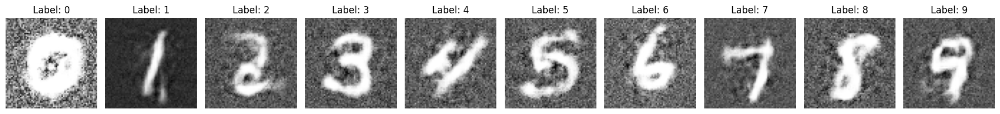

Epoch 56, Step 1871, D Loss: 0.5802, G Loss: 0.9357

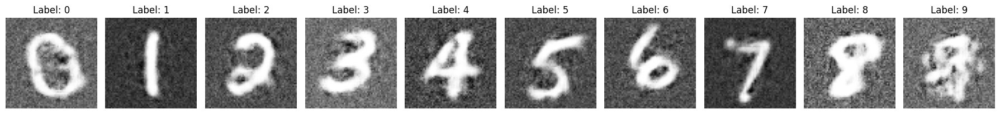

Epoch 57, Step 1871, D Loss: 0.5751, G Loss: 1.2914

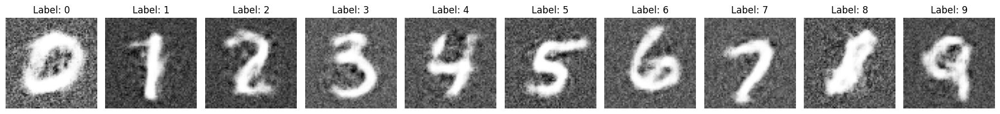

Epoch 58, Step 1871, D Loss: 0.5311, G Loss: 1.1005

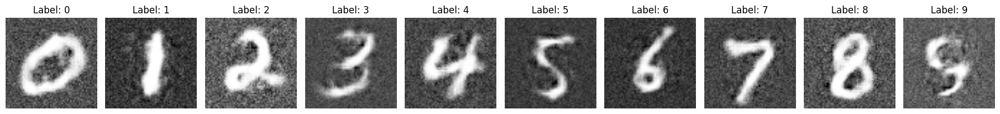

Epoch 59, Step 1871, D Loss: 0.6572, G Loss: 0.9277

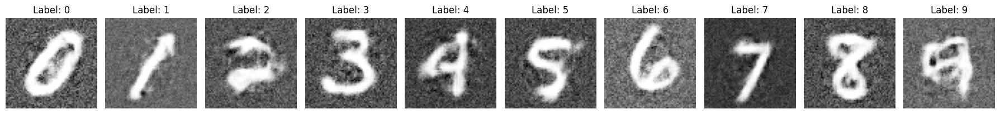

Epoch 60, Step 1871, D Loss: 0.6762, G Loss: 0.8935

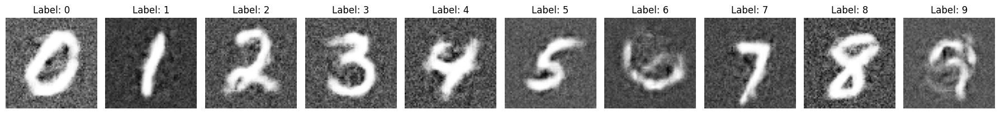

Epoch 61, Step 1871, D Loss: 0.5983, G Loss: 0.9296

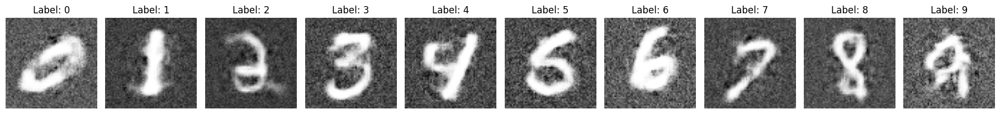

Epoch 62, Step 1871, D Loss: 0.6073, G Loss: 0.8419

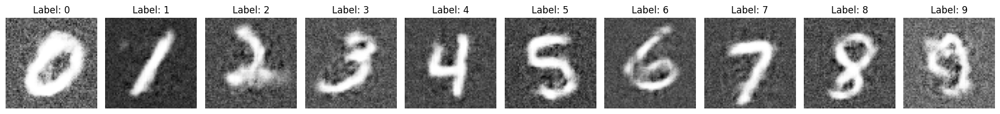

Epoch 63, Step 1871, D Loss: 0.5492, G Loss: 1.0206

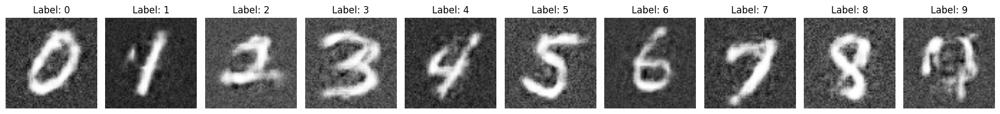

Epoch 64, Step 1871, D Loss: 0.6662, G Loss: 0.7806

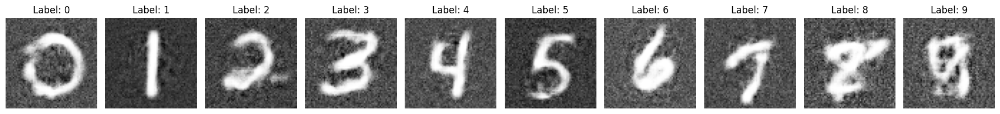

Epoch 65, Step 1871, D Loss: 0.6300, G Loss: 0.9464

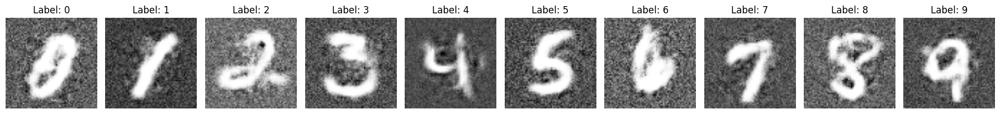

Epoch 66, Step 1871, D Loss: 0.6543, G Loss: 0.9078

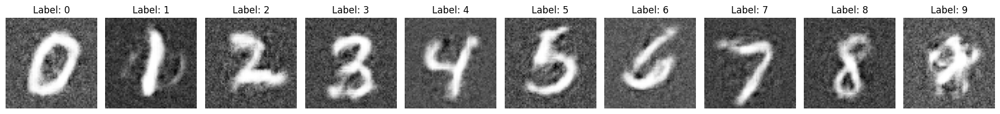

Epoch 67, Step 1871, D Loss: 0.6234, G Loss: 0.8993

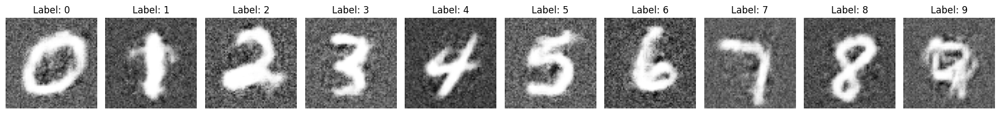

Epoch 68, Step 1871, D Loss: 0.5605, G Loss: 0.8761

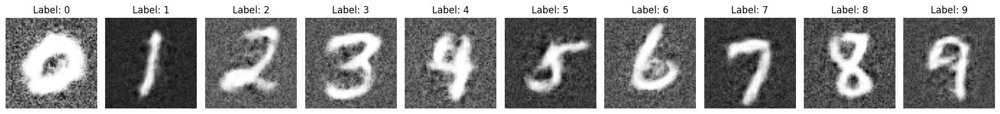

Epoch 69, Step 1871, D Loss: 0.5601, G Loss: 1.0444

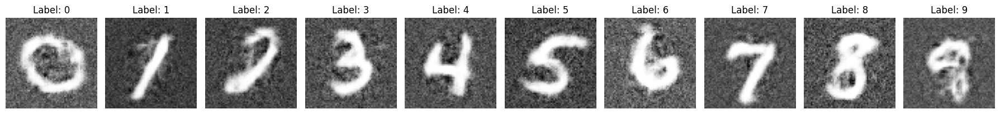

Epoch 70, Step 1871, D Loss: 0.5650, G Loss: 0.9878

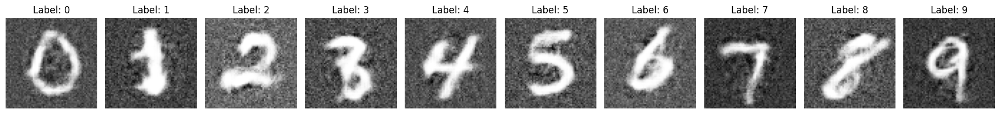

Epoch 71, Step 1871, D Loss: 0.5985, G Loss: 0.9910

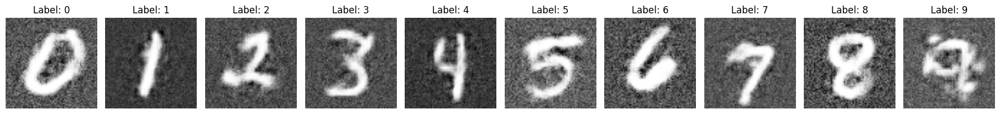

Epoch 72, Step 1871, D Loss: 0.6097, G Loss: 1.1996

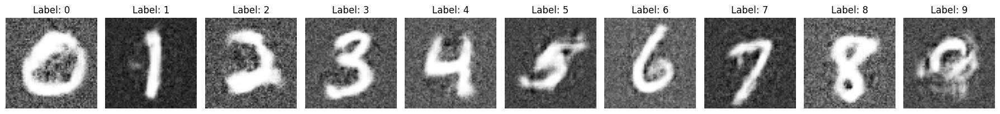

Epoch 73, Step 1871, D Loss: 0.6114, G Loss: 0.7840

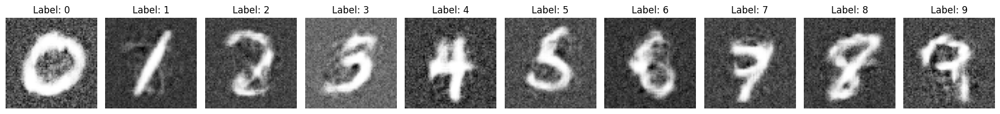

Epoch 74, Step 1871, D Loss: 0.6163, G Loss: 0.9169

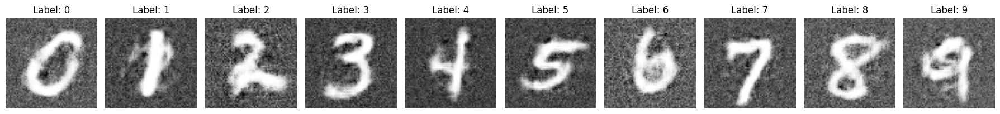

Epoch 75, Step 1871, D Loss: 0.5949, G Loss: 0.8630

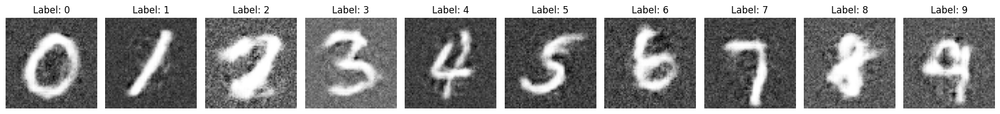

Epoch 76, Step 1871, D Loss: 0.6346, G Loss: 0.6814

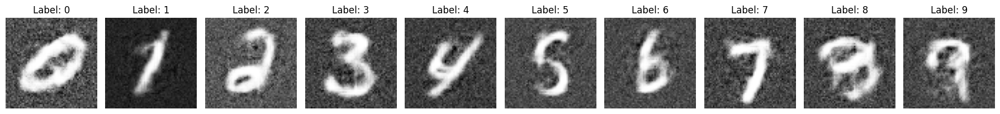

Epoch 77, Step 1871, D Loss: 0.6123, G Loss: 0.9351

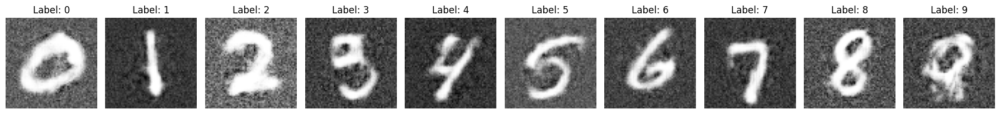

Epoch 78, Step 1871, D Loss: 0.7103, G Loss: 0.6064

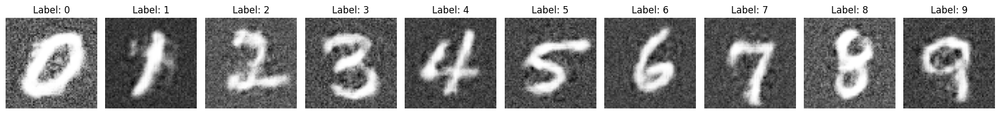

Epoch 79, Step 1871, D Loss: 0.5942, G Loss: 1.3371

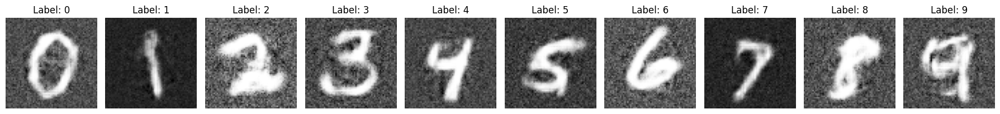

Epoch 80, Step 1871, D Loss: 0.6042, G Loss: 1.0322

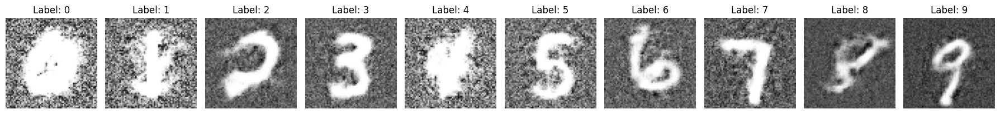

Epoch 81, Step 1871, D Loss: 0.5855, G Loss: 0.8594

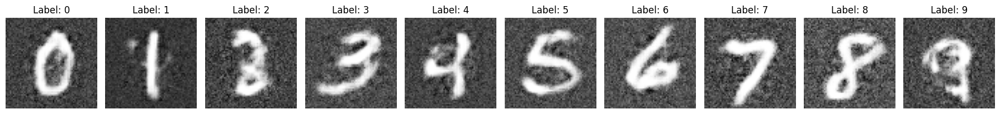

Epoch 82, Step 1871, D Loss: 0.6532, G Loss: 1.1285

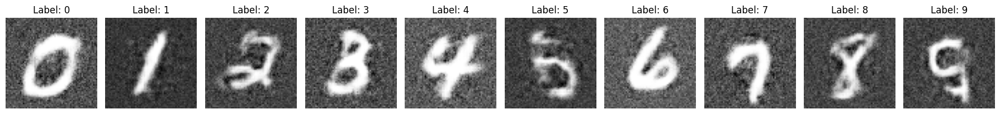

Epoch 83, Step 1871, D Loss: 0.6847, G Loss: 0.8413

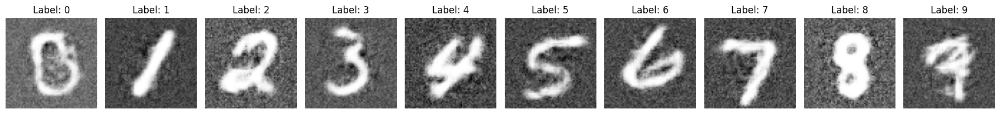

Epoch 84, Step 1871, D Loss: 0.7131, G Loss: 0.9640

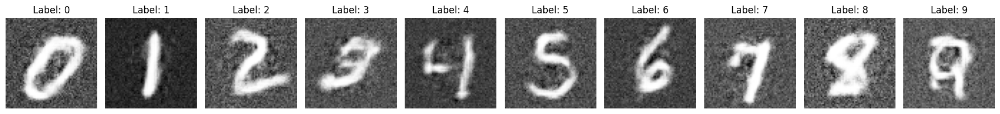

Epoch 85, Step 1251, D Loss: 0.5487, G Loss: 1.1823

In [ ]:
num_epochs = 85

# Labels for generated images
sample_labels = torch.randint(0, 10, (32,)).type(torch.LongTensor).cuda()

for epoch in range(num_epochs):
    for i, (imgs, labels) in enumerate(data_loader):

        batch_size = imgs.shape[0]

        # Adversarial ground truths
        valid = torch.ones(batch_size, 1).cuda()
        fake = torch.zeros(batch_size, 1).cuda()

        # Train Generator
        optimizer_G.zero_grad()

        # Sample noise and labels. Generate a batch of images and calculate and backpropagate g_loss
        z = torch.randn(batch_size, 100).cuda()
        gen_labels = Variable(torch.randint(0, 10, (batch_size,)).cuda())
        gen_imgs = generator(z, gen_labels)
        validity = discriminator(gen_imgs, gen_labels)
        g_loss = adversarial_loss(validity, valid)
        g_loss.backward()
        optimizer_G.step()

        # Train Discriminator
        optimizer_D.zero_grad()

        # Pass real and fake images to discriminator and backporpagate sum of real and fake losses
        real_pred = discriminator(imgs.cuda(), labels.cuda())
        d_real_loss = adversarial_loss(real_pred, valid)
        fake_pred = discriminator(gen_imgs.detach(), gen_labels)
        d_fake_loss = adversarial_loss(fake_pred, fake)

        d_loss = (d_real_loss + d_fake_loss) / 2
        d_loss.backward()
        optimizer_D.step()

        # Save training progress
        if i % 10 == 0:
            print(f'\rEpoch {epoch+1}, Step {i+1}, D Loss: {d_loss:.4f}, G Loss: {g_loss:.4f}', end='')

    save_fake_labled_images(epoch)

**Question:** [10 score]

With learned insights from the notebook, compare Conditional Generative Adversarial Networks (CGANs) and traditional Generative Adversarial Networks (GANs) in terms of architecture, input data, loss functions, and potential applications.

```

# Your Answer

**Answer:**

Comparing Conditional Generative Adversarial Networks (CGANs) and traditional Generative Adversarial Networks (GANs), the fundamental difference lies in their architecture. In traditional GANs, the generator and discriminator networks are trained using only noise as input for the generator, leading to the generation of images with no specific control over their content. In contrast, CGANs introduce additional label information both to the generator and discriminator, allowing the generation of images conditioned on these labels. This was evident in my experiments with the MNIST dataset, where the basic GAN produced diverse but uncontrolled digit images, while the CGAN, with label conditioning, showed a remarkable ability to generate specific digits, as observed in the evolution of the digit '9' from a mere noise with a white mask to a recognizable digit.

The input data in CGANs, therefore, includes not just the noise vector but also label information, which guides the image generation process. This architectural modification impacts the loss function as well. In CGANs, the discriminator's loss function must account for both the authenticity of the images and the correctness of the conditioned label, making it more complex compared to the loss function of traditional GANs, which only focuses on the authenticity. These differences significantly broaden the potential applications of CGANs. While traditional GANs are effective for generating diverse and realistic images, CGANs excel in tasks where control over specific features of the generated images is crucial, such as in targeted data augmentation, style transfer with specific attributes, or even in more complex tasks where generating data conditioned on certain labels is essential.

```

